In [1]:
import os
import re
import json

import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import anndata
from mgitools.os_helpers import listfiles

sct normalized count data

In [2]:
sct = sc.read_h5ad('../data/single_cell/original/integrated_sct.h5ad')
sct = anndata.AnnData(X=sct.raw.X,
                      obs=sct.obs,
                      var=sct.raw.var)
sct.var.index = sct.var['_index'].to_list()
sct

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/ipykernel_launcher.py:4: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  after removing the cwd from sys.path.


AnnData object with n_obs × n_vars = 113052 × 29227
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type'
    var: '_index'

raw count data

In [3]:
# raw counts are raw.X
counts = sc.read_h5ad('../data/single_cell/original/integrated_rna.h5ad')
counts.var = counts.var.set_index('features')
counts

AnnData object with n_obs × n_vars = 113052 × 31915
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type'
    var: '_index'
    obsm: 'X_umap'

pollock cell type predictions

In [4]:
pollock = sc.read_h5ad('../data/single_cell/pollock/pollock_adata.h5ad')
pollock

AnnData object with n_obs × n_vars = 113052 × 25019
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type', 'n_counts', 'size_factors', 'y_pred', 'predicted_cell_type_probability', 'predicted_cell_type', 'probability Acinar', 'probability B cell', 'probability CD4 T cell', 'probability CD8 T cell', 'probability Dendritic', 'probability Endothelial', 'probability Epithelial', 'probability Erythrocyte', 'probability Fibroblast', 'probability Islet', 'probability Malignant', 'probability Mast', 'probability Monocyte', 'probability NK', 'probability Plasma', 'probability Treg', 'probability Tuft'
    var: 'mean', 'std'
    uns: 'cell_type_colors', 'predicted_cell_type_colors'
    obsm: 'X_emb', 'X_umap', 'prediction_probs'

In [5]:
sct.obs['pollock_cell_type'] = [pollock.obs.loc[x, 'predicted_cell_type'] for x in sct.obs.index.to_list()]

map from cell to sample to dataset, etc.

In [6]:
cell_to_sample_id = {c:s if p=='NA' else p for c, s, p in zip(
    counts.obs.index.to_list(), counts.obs['sample_id'], counts.obs['Patient'])}
dataset_to_sample_id = {
    'in-house surgical': [
        '1555-tumor',
        'H_ZY-1105-07',
        'H_ZY-1160-06',
        'H_ZY-1174-06',
        'TWCE-HT055P-S1PAG',
        'TWCE-HT081P1-XB1'
    ],
    'lin': [
        'P01',
        'P02',
        'P03',
        'P04',
        'P05',
        'P06',
        'P07',
        'P08',
        'P09',
        'P10',
    ],
    'peng': [
        'T1',
        'T10',
        'T11',
        'T12',
        'T13',
        'T14',
        'T15',
        'T16',
        'T17',
        'T18',
        'T19',
        'T2',
        'T20',
        'T21',
        'T22',
        'T23',
        'T24',
        'T3',
        'T4',
        'T5',
        'T6',
        'T7',
        'T8',
        'T9',
    ],
    'chan-seng-yue': [
        '100070',
        '85948',
        '87235',
        '87784',
        '90209_CMP',
        '91412',
        '91610',
        '91706',
        '94930',
        '95092',
        '95373',
        '96460',
        '97727',
        'COMP_0158_P',
        'G9903',
    ]
}
sample_id_to_dataset = {v:k for k, vs in dataset_to_sample_id.items() for v in vs}
cell_to_dataset = {c:sample_id_to_dataset[cell_to_sample_id[c]] for c in counts.obs.index.to_list()}

In [7]:
sct.obs['dataset'] = [cell_to_dataset[x] for x in sct.obs.index.to_list()]
sct.obs['sample_id'] = [cell_to_sample_id[x] for x in sct.obs.index.to_list()]

score cells for gene sets in literature

In [8]:
gene_sets = json.load(open('../data/single_cell/gene_sets/pdac_gene_sets.json'))
imm_gene_sets = json.load(open('../data/single_cell/gene_sets/immune_gene_sets.json'))
gene_sets['MCPcounter'] = {k:v for k, v in imm_gene_sets.items() if 'MCPcounter' in k}
gene_sets['Immunophenogram'] = {k:v for k, v in imm_gene_sets.items() if 'Immunophenogram' in k}
gene_sets['CYT'] = {k:v for k, v in imm_gene_sets.items() if 'CYT' in k}

for k, v in gene_sets.items():
    print(k, v.keys())

Bailey dict_keys(['ADEX', 'Squamous-like', 'Pancreatic-Progenitor', 'Immunogenic'])
Collison dict_keys(['Exocrine-like', 'Quasi-Mesenchymal', 'Classical'])
Moffit dict_keys(['Basal', 'Classical'])
subTME dict_keys(['deserted', 'reactive'])
raghaven dict_keys(['scBasal', 'scClassical', 'IC', 'Pericyte-like', 'Fibroblast-like', 'Inflammatory', 'TAM-FCN1', 'TAM-C1QC', 'TAM-SPP1'])
elyada dict_keys(['myCAF', 'iCAF', 'apCAF'])
ben-porath dict_keys(['ES exp1', 'ES exp2', 'Nanog targets', 'Oct4 targets', 'Sox2 targets', 'NOS targets', 'NOS TFs', 'Suz12 targets', 'Eed targets', 'H3K27 bound', 'PRC2 targets', 'Myc targets1', 'Myc targets2', 'Genes functionally associated with proliferation', 'Cycling genes', 'Proliferation cluster', 'ES TFs'])
wong dict_keys(['stem_core'])
sanchez-vega dict_keys(['Cell Cycle', 'HIPPO', 'MYC', 'NOTCH', 'NRF2', 'PI3K', 'TGF-Beta', 'RTK RAS', 'TP53', 'WNT'])
Chan-Seng-Yue dict_keys(['Signature 2 (Basal-like A)', 'Signature 10 (Basal-like B)', 'Signature 1 (Classic

In [9]:
def score_signatures(a, gene_sets):
    for name, v in gene_sets.items():
        for gs, genes in v.items():
            ls = [g for g in genes if g in a.var.index.to_list()]
            sc.tl.score_genes(a, gene_list=ls, score_name=f'{name} | {gs} | score')

In [10]:
score_signatures(sct, gene_sets)

copykat results

In [11]:
def deRify_cell_id(cid):
    if cid[0].lower() == 'x':
        cid = cid[1:]
    
    if 'h5.h5' in cid:
        cid = cid.replace('.1', '-1')
    else:
        cid = cid.replace('.', '-')
    
    return cid

In [12]:
## read in copy number results
fps = sorted(listfiles('../data/single_cell/copycat/outputs/', regex=r'_predictions.txt$'))

cell_to_copykat = {}
for fp in fps:
    df = pd.read_csv(fp, sep='\t')
    df = df.set_index('cell.names')
    cell_to_copykat.update({deRify_cell_id(k):v for k, v in zip(df.index, df['copykat.pred'])})
len(cell_to_copykat)

113052

In [13]:
fps = sorted(listfiles('../data/single_cell/copycat/outputs/', regex=r'_cna.txt$'))

cell_to_cna = {}
for fp in fps:
    print(fp)
    df = pd.read_csv(fp, sep='\t')
    cnas = np.count_nonzero(np.abs(df.values[:, 3:]) > .2, axis=0) # 99%
    cell_to_cna.update({deRify_cell_id(k):v for k, v in zip(df.columns[3:], cnas)})
len(cell_to_cna)

../data/single_cell/copycat/outputs/100070_cna.txt
../data/single_cell/copycat/outputs/1555-tumor_cna.txt
../data/single_cell/copycat/outputs/85948_cna.txt
../data/single_cell/copycat/outputs/87235_cna.txt
../data/single_cell/copycat/outputs/87784_cna.txt
../data/single_cell/copycat/outputs/90209_CMP_cna.txt
../data/single_cell/copycat/outputs/91412_cna.txt
../data/single_cell/copycat/outputs/91610_cna.txt
../data/single_cell/copycat/outputs/91706_cna.txt
../data/single_cell/copycat/outputs/94930_cna.txt
../data/single_cell/copycat/outputs/95092_cna.txt
../data/single_cell/copycat/outputs/95373_cna.txt
../data/single_cell/copycat/outputs/96460_cna.txt
../data/single_cell/copycat/outputs/97727_cna.txt
../data/single_cell/copycat/outputs/COMP_0158_P_cna.txt
../data/single_cell/copycat/outputs/G9903_cna.txt
../data/single_cell/copycat/outputs/H_ZY-1105-07_cna.txt
../data/single_cell/copycat/outputs/H_ZY-1160-06_cna.txt
../data/single_cell/copycat/outputs/H_ZY-1174-06_cna.txt
../data/singl

92299

In [14]:
sct.obs['copykat_prediction'] = [cell_to_copykat.get(x, 'not.defined') for x in sct.obs.index.to_list()]
sct.obs['copykat_cna_count'] = [cell_to_cna.get(x, np.nan) for x in sct.obs.index.to_list()]

cytotrace results

In [15]:
cytotrace = pd.read_csv('../data/single_cell/cytotrace/outputs/malignant_cytotrace.txt', sep='\t')
cytotrace.index = [deRify_cell_id(x) for x in cytotrace.index]
cytotrace

,results$CytoTRACE,CytoTRACE,CytoTRACErank,GCS,Counts
1555-tumor_AAACCTGAGTGCGTGA-1,0.875252,0.875252,871,0.011415,0.511694
1555-tumor_AAACGGGAGACAATAC-1,0.984909,0.984909,980,0.011167,0.491271
1555-tumor_AACCATGGTACTTCTT-1,0.245473,0.245473,245,0.003492,0.081270
1555-tumor_AACCATGTCCCTCAGT-1,0.160966,0.160966,161,0.001653,0.014417
1555-tumor_AACCATGTCGTGGTCG-1,0.996982,0.996982,992,0.011655,0.625648
...,...,...,...,...,...
G9903_filtered_gene_bc_matrices_h5.h5_TTTGCGCCACAGGAGT-1,0.743461,0.743461,740,0.011040,0.365451
G9903_filtered_gene_bc_matrices_h5.h5_TTTGCGCGTACCGTAT-1,0.851107,0.851107,847,0.012186,0.552382
G9903_filtered_gene_bc_matrices_h5.h5_TTTGCGCTCGTGGACC-1,0.609658,0.609658,607,0.010148,0.323100
G9903_filtered_gene_bc_matrices_h5.h5_TTTGGTTGTTGTACAC-1,0.736419,0.736419,733,0.010374,0.449656


In [16]:
sct.obs['cytotrace'] = [cytotrace.loc[x, 'CytoTRACE'] if x in cytotrace.index else np.nan
                        for x in sct.obs.index.to_list()]
sct.obs['cytotrace_malignant'] = sct.obs['cytotrace'].to_list()

In [17]:
cytogenes = pd.read_csv('../data/single_cell/cytotrace/outputs/malignant_cytogenes.txt', sep='\t')
cytogenes

,results$cytoGenes,cytoGenes
A1BG,0.041740,0.041740
A1CF,-0.019122,-0.019122
A2M,-0.134474,-0.134474
A2ML1,0.196874,0.196874
A4GALT,0.192868,0.192868
...,...,...
ZXDC,0.095941,0.095941
ZYG11B,0.127440,0.127440
ZYX,0.257231,0.257231
ZZEF1,0.059561,0.059561


In [18]:
sct.uns['cytogenes_malignant'] = {g:s for g, s in zip(cytogenes.index.to_list(), cytogenes['cytoGenes'])}

In [99]:
cytotrace = pd.read_csv('../data/single_cell/cytotrace/outputs/mesenchymal_cytotrace.txt', sep='\t')
cytotrace.index = [deRify_cell_id(x) for x in cytotrace.index]
sct.obs['cytotrace_mesenchymal'] = [cytotrace.loc[x, 'CytoTRACE'] if x in cytotrace.index else np.nan
                        for x in sct.obs.index.to_list()]

In [100]:
cytogenes = pd.read_csv('../data/single_cell/cytotrace/outputs/mesenchymal_cytogenes.txt', sep='\t')
sct.uns['cytogenes_mesenchymal'] = {g:s for g, s in zip(cytogenes.index.to_list(), cytogenes['cytoGenes'])}

#### malignant cell typing

In [19]:
malignant = sc.read_h5ad('../data/single_cell/original/integrated_subset_malignant.h5ad')
malignant.raw = sct[malignant.obs.index.to_list()]
keep = [c for c in sct.obs.columns
        if c not in malignant.obs]
malignant.obs = pd.merge(malignant.obs, sct[malignant.obs.index.to_list()].obs[keep],
                         how='left', left_index=True, right_index=True)
malignant

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,


AnnData object with n_obs × n_vars = 50715 × 3000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type', 'integrated_snn_res.2', 'pollock_cell_type', 'dataset', 'Bailey | ADEX | score', 'Bailey | Squamous-like | score', 'Bailey | Pancreatic-Progenitor | score', 'Bailey | Immunogenic | score', 'Collison | Exocrine-like | score', 'Collison | Quasi-Mesenchymal | score', 'Collison | Classical | score', 'Moffit | Basal | score', 'Moffit | Classical | score', 'subTME | deserted | score', 'subTME | reactive | score', 'raghaven | scBasal | score', 'raghaven | scClassical | score', 'raghaven | IC | score', 'raghaven | Pericyte-like | score', 'raghaven | Fibroblast-like | score', 'raghaven | Inflammatory | score', 'raghaven | TAM-FCN1 | score', 'raghaven | TAM-C1QC | score', 'raghaven | TAM-SPP1 | score', 'elyada | myCAF | score', 

In [20]:
# label scClassical, scBasal, IC, ADM
# label proliferating sub-populations

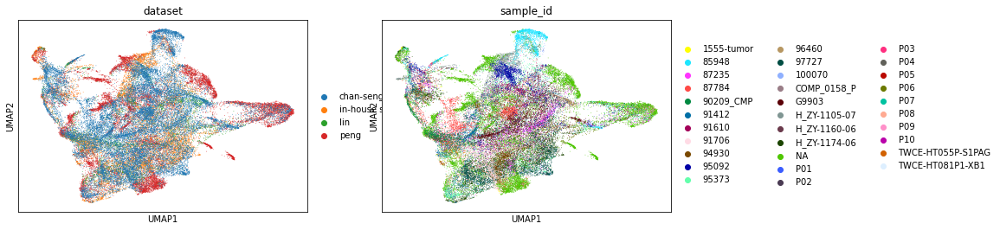

In [21]:
sc.pl.umap(malignant, color=['dataset', 'sample_id'])

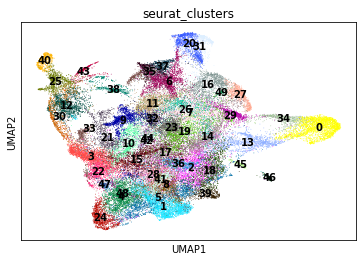

In [22]:
sc.pl.umap(malignant, color=['seurat_clusters'], legend_loc='on data', )

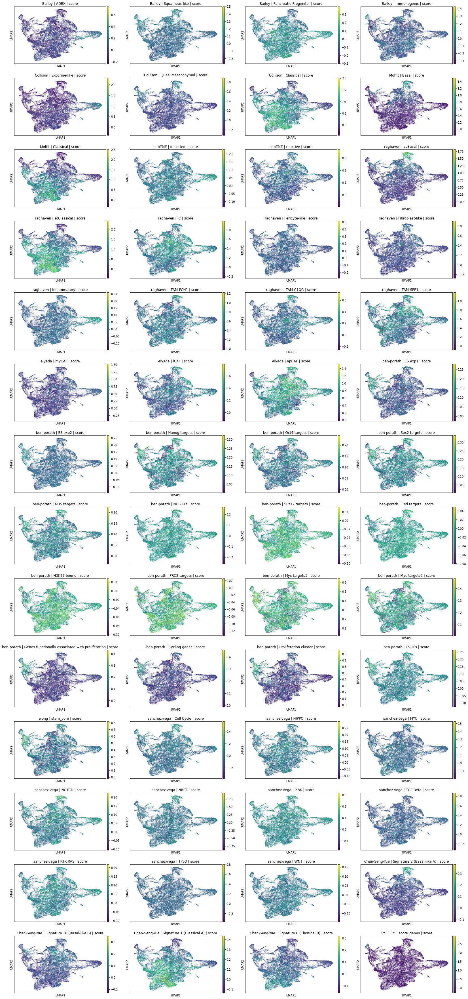

In [23]:
cols = [c for c in malignant.obs.columns if 'score' in c if 'Immunophenogram' not in c if 'MCP' not in c]
sc.pl.umap(malignant, color=cols)

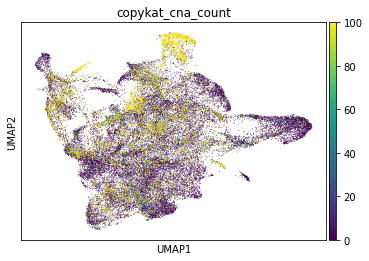

In [24]:
sc.pl.umap(malignant, color=['copykat_cna_count'], vmax=100)

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/contextlib.py:119: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)


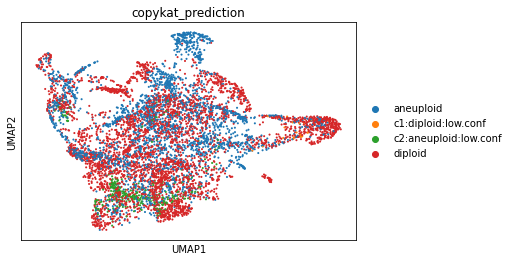

In [25]:
sc.pl.umap(malignant[malignant.obs['copykat_prediction']!='not.defined'], color=['copykat_prediction'])

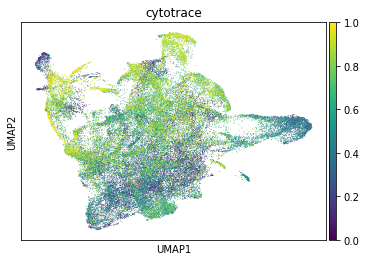

In [26]:
sc.pl.umap(malignant, color=['cytotrace'])

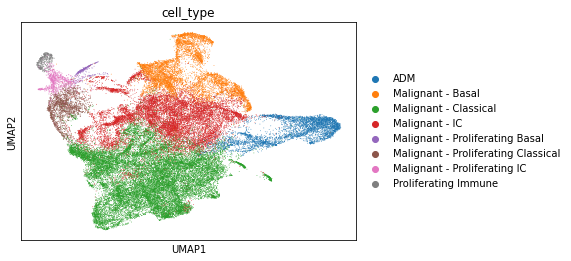

In [29]:
m = {
    'Malignant - Basal': [20, 31, 35, 37, 6, 16, 49, 27],
    'Malignant - IC': [21, 33, 32, 38, 11, 26, 7, 29, 9, 12, 23, 19, 14],
    'Malignant - Classical': [42, 45, 10, 44, 17, 36, 2, 18, 3, 22, 15, 28, 41, 8, 39, 47, 48, 4, 5, 1, 24, 46],
    'Malignant - Proliferating Basal': [43],
    'Malignant - Proliferating IC': [25],
    'Malignant - Proliferating Classical': [12, 30],
    'ADM': [34, 0, 13],
    'Proliferating Immune': [40]
}
rm = {str(c):k for k, v in m.items() for c in v}
malignant.obs['cell_type'] = [rm.get(c) for c in malignant.obs['seurat_clusters']]
sc.pl.umap(malignant, color='cell_type')

In [30]:
# sc.pl.umap(malignant[pd.isnull(malignant.obs['cell_type'])], color='seurat_clusters')

In [31]:
c2t = {c:t for c, t in zip(malignant.obs.index, malignant.obs['cell_type'])}
sct.obs['cell_type_specific'] = [c2t.get(x) for x in sct.obs.index]

#### nkt subtyping

In [32]:
nkt = sc.read_h5ad('../data/single_cell/original/integrated_subset_nkt.h5ad')
nkt.raw = sct[nkt.obs.index.to_list()]
keep = [c for c in sct.obs.columns
        if c not in nkt.obs]
nkt.obs = pd.merge(nkt.obs, sct[nkt.obs.index.to_list()].obs[keep],
                         how='left', left_index=True, right_index=True)
nkt

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,


AnnData object with n_obs × n_vars = 11607 × 3000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type', 'integrated_snn_res.2', 'pollock_cell_type', 'dataset', 'Bailey | ADEX | score', 'Bailey | Squamous-like | score', 'Bailey | Pancreatic-Progenitor | score', 'Bailey | Immunogenic | score', 'Collison | Exocrine-like | score', 'Collison | Quasi-Mesenchymal | score', 'Collison | Classical | score', 'Moffit | Basal | score', 'Moffit | Classical | score', 'subTME | deserted | score', 'subTME | reactive | score', 'raghaven | scBasal | score', 'raghaven | scClassical | score', 'raghaven | IC | score', 'raghaven | Pericyte-like | score', 'raghaven | Fibroblast-like | score', 'raghaven | Inflammatory | score', 'raghaven | TAM-FCN1 | score', 'raghaven | TAM-C1QC | score', 'raghaven | TAM-SPP1 | score', 'elyada | myCAF | score', 

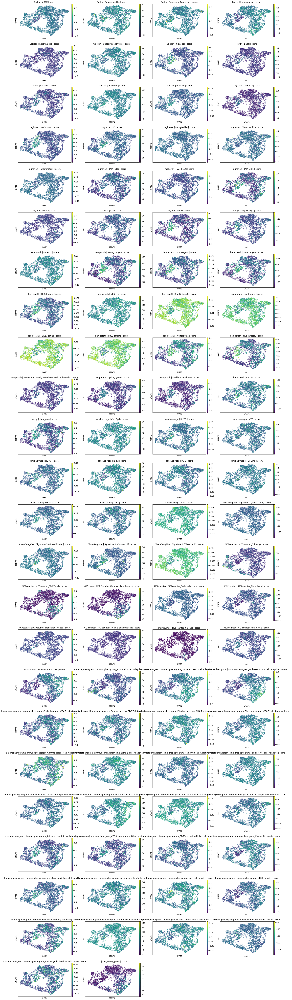

In [33]:
cols = [c for c in nkt.obs.columns if 'score' in c]
sc.pl.umap(nkt, color=cols)

In [34]:
# label cd4, cd8, cd8 ex, nk, treg
# label malignant
# exclude other

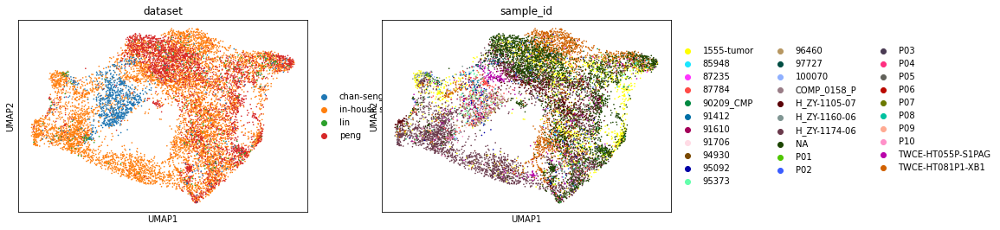

In [35]:
sc.pl.umap(nkt, color=['dataset', 'sample_id'])

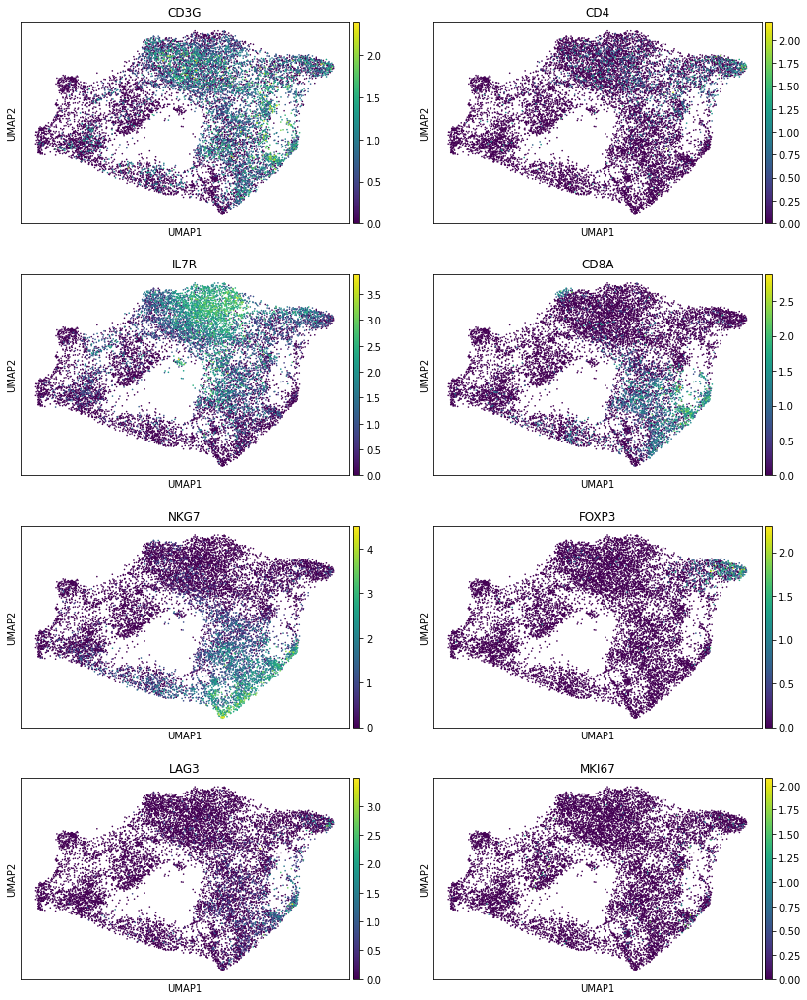

In [36]:
sc.pl.umap(nkt, color=['CD3G', 'CD4', 'IL7R', 'CD8A', 'NKG7', 'FOXP3', 'LAG3', 'MKI67'], ncols=2)

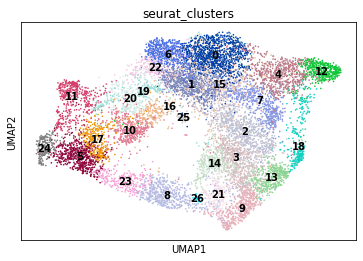

In [37]:
sc.pl.umap(nkt, color=['seurat_clusters'], legend_loc='on data', )

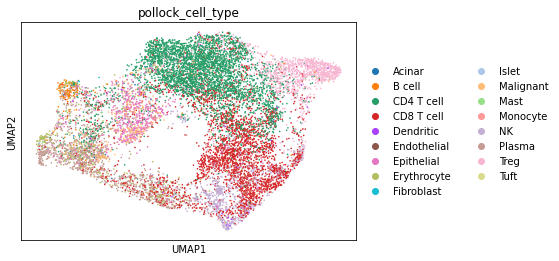

In [38]:
sc.pl.umap(nkt, color=['pollock_cell_type'])

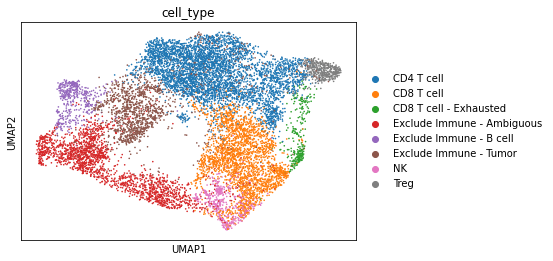

In [64]:
m = {
    'CD4 T cell': [6, 0, 22, 1, 15, 4, 7, 25],
    'CD8 T cell': [2, 3, 14, 13],
    'CD8 T cell - Exhausted': [18],
    'NK': [21, 26],
    'Treg': [12],
    'Exclude Immune - Tumor': [20, 19, 10, 16],
    'Exclude Immune - B cell': [11],
    'Exclude Immune - Ambiguous': [17, 24, 5, 23, 8, ]
}
rm = {str(c):k for k, v in m.items() for c in v}
nkt.obs['cell_type'] = [rm.get(c) for c in nkt.obs['seurat_clusters']]
# for cluster 9 you need to split based on pollock prediction since cd8/nk didnt seperate
nkt.obs['cell_type'] = [c if not pd.isnull(c) else 'NK' if pc=='NK' else 'CD8 T cell'
                        for c, pc in zip(nkt.obs['cell_type'], nkt.obs['pollock_cell_type'])]
sc.pl.umap(nkt, color='cell_type')

In [65]:
c2t = {c:t for c, t in zip(nkt.obs.index, nkt.obs['cell_type'])}
sct.obs['cell_type_specific'] = [c2t[x] if x in c2t else ct
                        for x, ct in zip(sct.obs.index, sct.obs['cell_type_specific'])]

#### monocyte subtyping

In [41]:
mono = sc.read_h5ad('../data/single_cell/original/integrated_subset_monodc.h5ad')
mono.raw = sct[mono.obs.index.to_list()]
keep = [c for c in sct.obs.columns
        if c not in mono.obs]
mono.obs = pd.merge(mono.obs, sct[mono.obs.index.to_list()].obs[keep],
                         how='left', left_index=True, right_index=True)
mono

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,


AnnData object with n_obs × n_vars = 12422 × 3000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type', 'integrated_snn_res.2', 'pollock_cell_type', 'dataset', 'Bailey | ADEX | score', 'Bailey | Squamous-like | score', 'Bailey | Pancreatic-Progenitor | score', 'Bailey | Immunogenic | score', 'Collison | Exocrine-like | score', 'Collison | Quasi-Mesenchymal | score', 'Collison | Classical | score', 'Moffit | Basal | score', 'Moffit | Classical | score', 'subTME | deserted | score', 'subTME | reactive | score', 'raghaven | scBasal | score', 'raghaven | scClassical | score', 'raghaven | IC | score', 'raghaven | Pericyte-like | score', 'raghaven | Fibroblast-like | score', 'raghaven | Inflammatory | score', 'raghaven | TAM-FCN1 | score', 'raghaven | TAM-C1QC | score', 'raghaven | TAM-SPP1 | score', 'elyada | myCAF | score', 

In [42]:
# label TAM-FCN1, TAM-C1QC, TAM-SPP1, DC, pDC

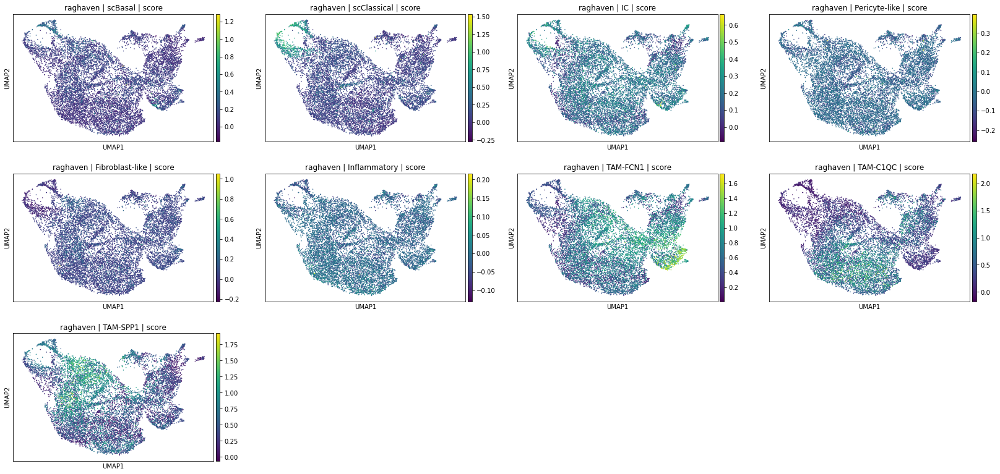

In [43]:
cols = [c for c in mono.obs.columns if 'score' in c if 'raghaven' in c]
sc.pl.umap(mono, color=cols)

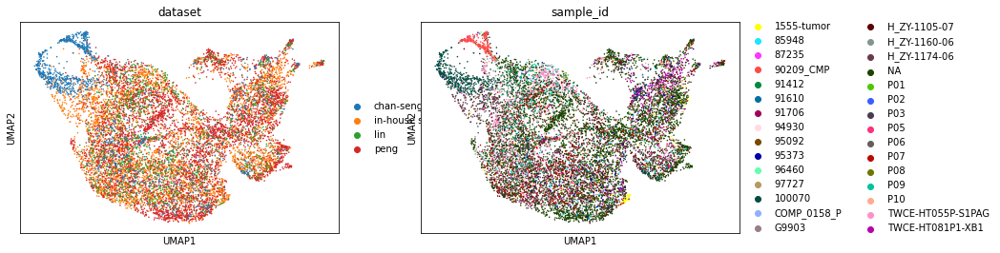

In [44]:
sc.pl.umap(mono, color=['dataset', 'sample_id'])

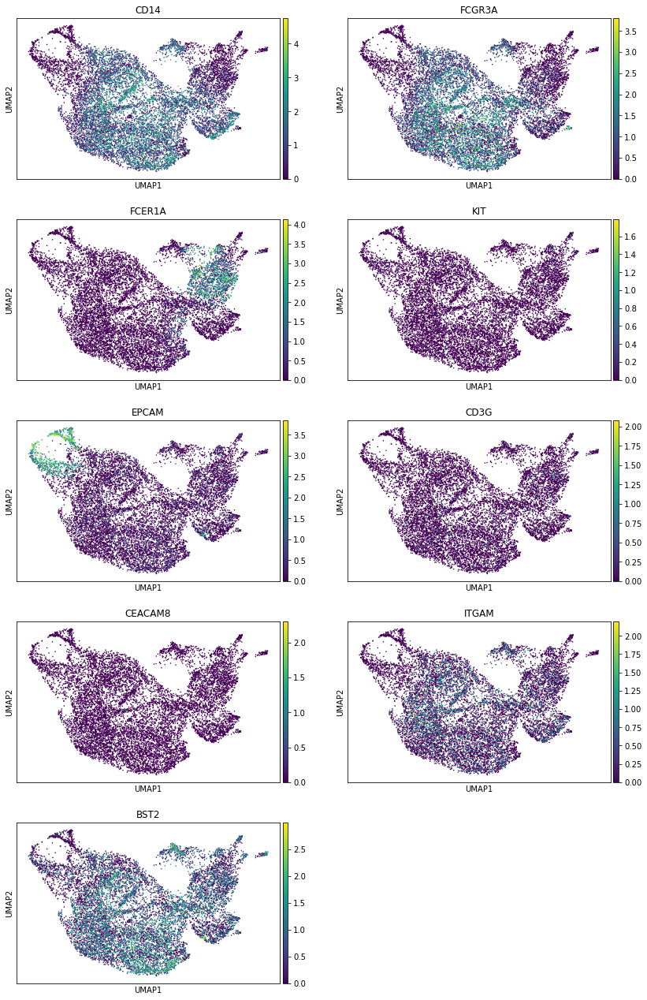

In [45]:
sc.pl.umap(mono, color=['CD14', 'FCGR3A', 'FCER1A', 'KIT', 'EPCAM', 'CD3G', 'CEACAM8', 'ITGAM', 'BST2'], ncols=2)

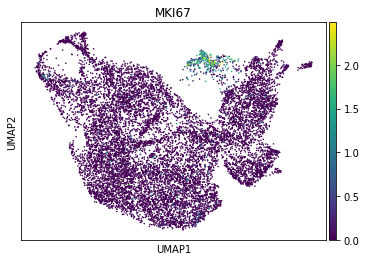

In [46]:
sc.pl.umap(mono, color=['MKI67'], ncols=2)

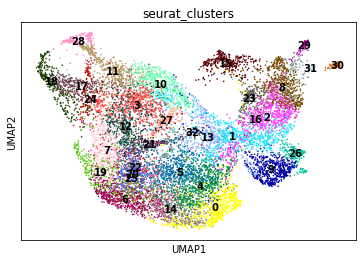

In [47]:
sc.pl.umap(mono, color=['seurat_clusters'], legend_loc='on data', )

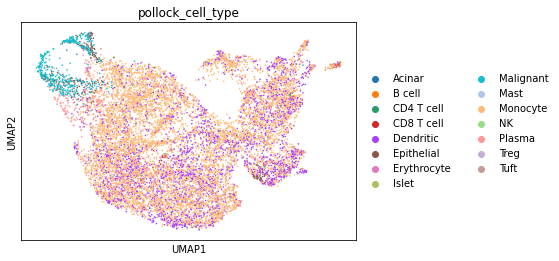

In [48]:
sc.pl.umap(mono, color=['pollock_cell_type'])

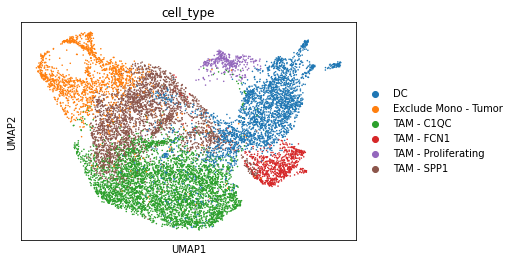

In [49]:
m = {
    'TAM - FCN1': [9, 26],
    'TAM - C1QC': [19, 6, 14, 0, 4, 5, 25, 22, 21, 20],
    'TAM - SPP1': [10, 3, 27, 32, 13, 12, 7],
    'DC': [16, 2, 23, 8, 31, 30, 29, 1],
    'TAM - Proliferating': [15],
    'Exclude Mono - Tumor': [28, 11, 18, 17, 24],
}
rm = {str(c):k for k, v in m.items() for c in v}
mono.obs['cell_type'] = [rm.get(c) for c in mono.obs['seurat_clusters']]
sc.pl.umap(mono, color='cell_type')

In [50]:
c2t = {c:t for c, t in zip(mono.obs.index, mono.obs['cell_type'])}
sct.obs['cell_type_specific'] = [c2t[x] if x in c2t else ct
                        for x, ct in zip(sct.obs.index, sct.obs['cell_type_specific'])]

#### fibroblast subtyping

In [51]:
caf = sc.read_h5ad('../data/single_cell/original/integrated_subset_fibroblast.h5ad')
caf.raw = sct[caf.obs.index.to_list()]
keep = [c for c in sct.obs.columns
        if c not in caf.obs]
caf.obs = pd.merge(caf.obs, sct[caf.obs.index.to_list()].obs[keep],
                         how='left', left_index=True, right_index=True)
caf

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,


AnnData object with n_obs × n_vars = 10793 × 3000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type', 'integrated_snn_res.2', 'pollock_cell_type', 'dataset', 'Bailey | ADEX | score', 'Bailey | Squamous-like | score', 'Bailey | Pancreatic-Progenitor | score', 'Bailey | Immunogenic | score', 'Collison | Exocrine-like | score', 'Collison | Quasi-Mesenchymal | score', 'Collison | Classical | score', 'Moffit | Basal | score', 'Moffit | Classical | score', 'subTME | deserted | score', 'subTME | reactive | score', 'raghaven | scBasal | score', 'raghaven | scClassical | score', 'raghaven | IC | score', 'raghaven | Pericyte-like | score', 'raghaven | Fibroblast-like | score', 'raghaven | Inflammatory | score', 'raghaven | TAM-FCN1 | score', 'raghaven | TAM-C1QC | score', 'raghaven | TAM-SPP1 | score', 'elyada | myCAF | score', 

In [52]:
# label icaf, mycaf

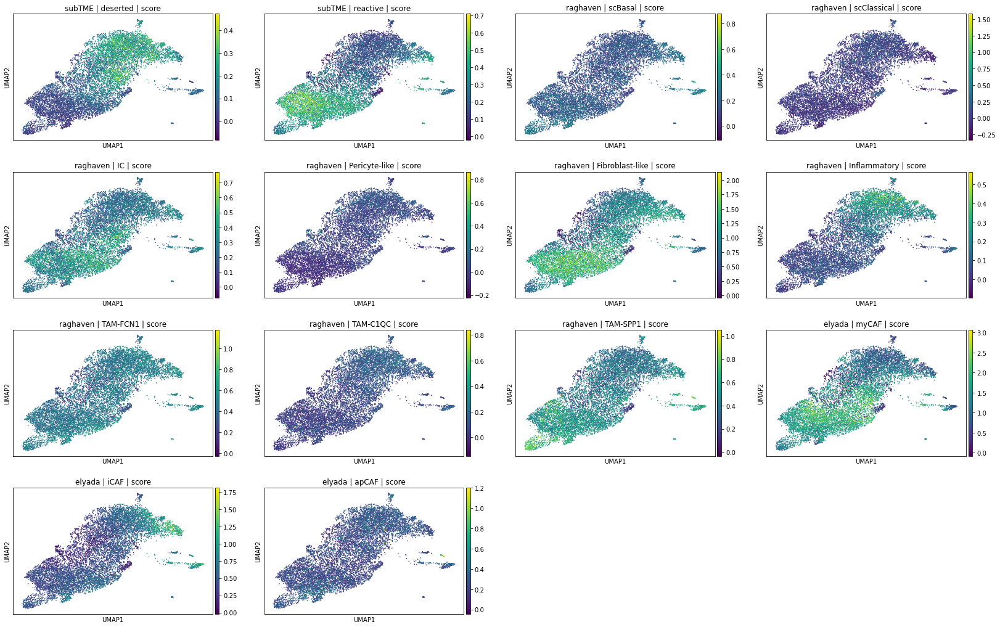

In [53]:
cols = [c for c in caf.obs.columns if 'score' in c and ('elyada' in c or 'subTME' in c or 'raghaven' in c)]
sc.pl.umap(caf, color=cols)

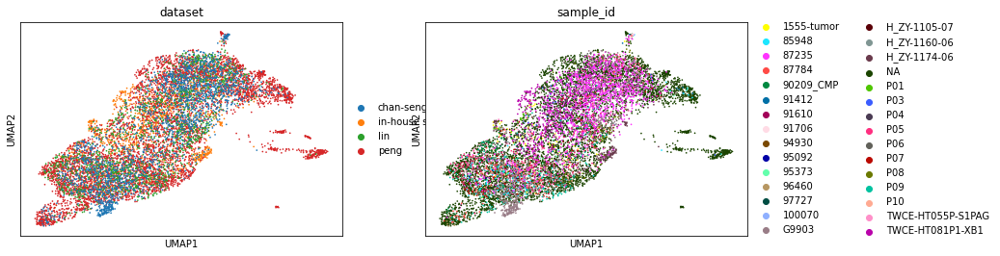

In [54]:
sc.pl.umap(caf, color=['dataset', 'sample_id'])

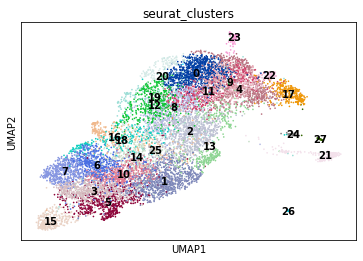

In [55]:
sc.pl.umap(caf, color=['seurat_clusters'], legend_loc='on data', )

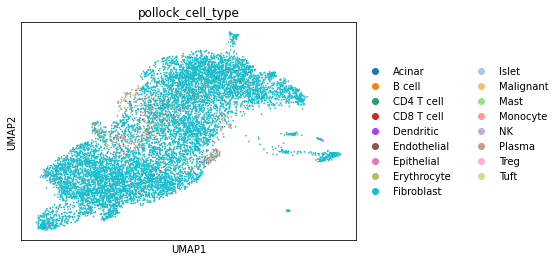

In [56]:
sc.pl.umap(caf, color=['pollock_cell_type'])

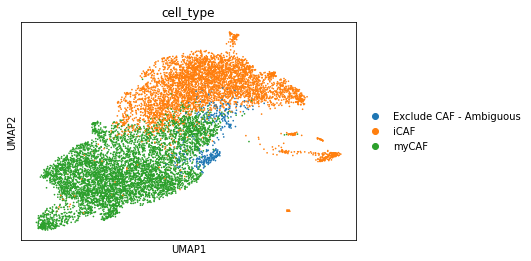

In [57]:
m = {
    'iCAF': [23, 22, 17, 20, 0, 9, 4, 11, 8, 19, 12, 24, 27, 21, 26],
    'myCAF': [15, 5, 3, 7, 6, 10, 1, 14, 16, 18, 25, 2],
    'Exclude CAF - Ambiguous': [13],
}
rm = {str(c):k for k, v in m.items() for c in v}
caf.obs['cell_type'] = [rm.get(c) for c in caf.obs['seurat_clusters']]
sc.pl.umap(caf, color='cell_type')

In [58]:
c2t = {c:t for c, t in zip(caf.obs.index, caf.obs['cell_type'])}
sct.obs['cell_type_specific'] = [c2t[x] if x in c2t else ct
                        for x, ct in zip(sct.obs.index, sct.obs['cell_type_specific'])]

#### Endothelial

In [80]:
end = sc.read_h5ad('../data/single_cell/original/integrated_subset_endothelial.h5ad')
end.raw = sct[end.obs.index.to_list()]
keep = [c for c in sct.obs.columns
        if c not in end.obs]
end.obs = pd.merge(end.obs, sct[end.obs.index.to_list()].obs[keep],
                         how='left', left_index=True, right_index=True)
end

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,


AnnData object with n_obs × n_vars = 6161 × 3000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type', 'integrated_snn_res.2', 'pollock_cell_type', 'dataset', 'Bailey | ADEX | score', 'Bailey | Squamous-like | score', 'Bailey | Pancreatic-Progenitor | score', 'Bailey | Immunogenic | score', 'Collison | Exocrine-like | score', 'Collison | Quasi-Mesenchymal | score', 'Collison | Classical | score', 'Moffit | Basal | score', 'Moffit | Classical | score', 'subTME | deserted | score', 'subTME | reactive | score', 'raghaven | scBasal | score', 'raghaven | scClassical | score', 'raghaven | IC | score', 'raghaven | Pericyte-like | score', 'raghaven | Fibroblast-like | score', 'raghaven | Inflammatory | score', 'raghaven | TAM-FCN1 | score', 'raghaven | TAM-C1QC | score', 'raghaven | TAM-SPP1 | score', 'elyada | myCAF | score', '

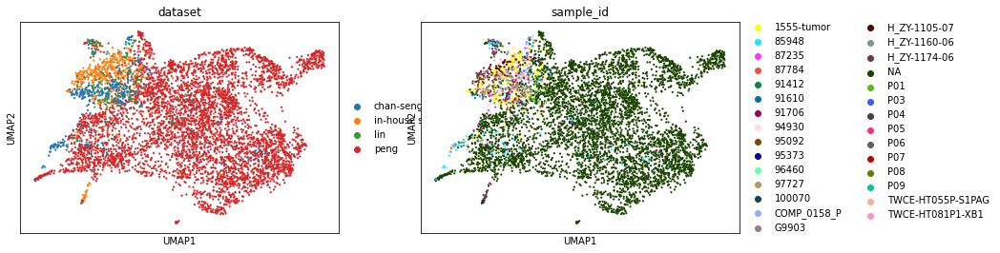

In [81]:
sc.pl.umap(end, color=['dataset', 'sample_id'])

#### Mixed

In [85]:
mix = sc.read_h5ad('../data/single_cell/original/integrated_subset_mixed.h5ad')
mix.raw = sct[mix.obs.index.to_list()]
keep = [c for c in sct.obs.columns
        if c not in mix.obs]
mix.obs = pd.merge(mix.obs, sct[mix.obs.index.to_list()].obs[keep],
                         how='left', left_index=True, right_index=True)
mix

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,


AnnData object with n_obs × n_vars = 3464 × 3000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type', 'integrated_snn_res.2', 'pollock_cell_type', 'dataset', 'Bailey | ADEX | score', 'Bailey | Squamous-like | score', 'Bailey | Pancreatic-Progenitor | score', 'Bailey | Immunogenic | score', 'Collison | Exocrine-like | score', 'Collison | Quasi-Mesenchymal | score', 'Collison | Classical | score', 'Moffit | Basal | score', 'Moffit | Classical | score', 'subTME | deserted | score', 'subTME | reactive | score', 'raghaven | scBasal | score', 'raghaven | scClassical | score', 'raghaven | IC | score', 'raghaven | Pericyte-like | score', 'raghaven | Fibroblast-like | score', 'raghaven | Inflammatory | score', 'raghaven | TAM-FCN1 | score', 'raghaven | TAM-C1QC | score', 'raghaven | TAM-SPP1 | score', 'elyada | myCAF | score', '

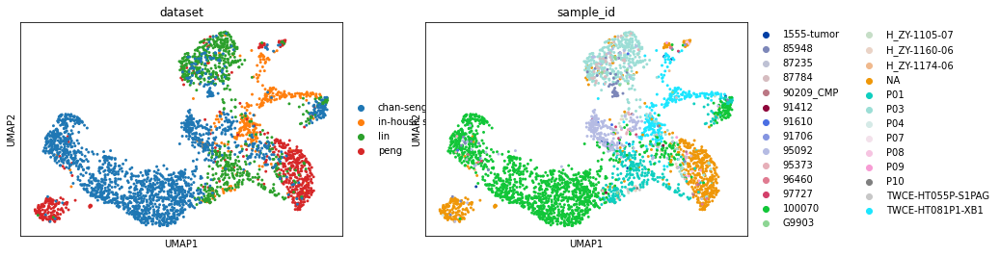

In [86]:
sc.pl.umap(mix, color=['dataset', 'sample_id'])

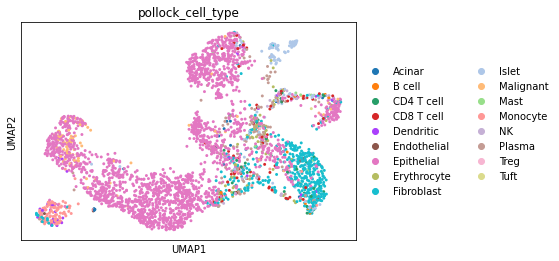

In [87]:
sc.pl.umap(mix, color=['pollock_cell_type'])

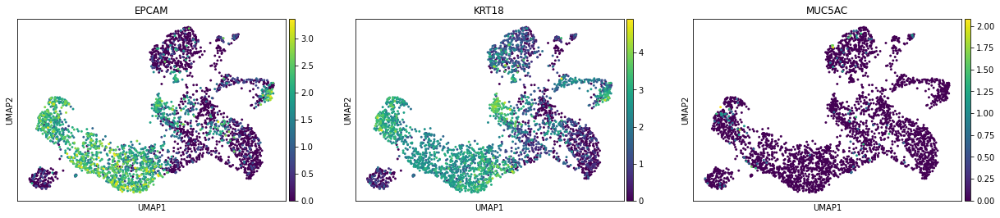

In [89]:
sc.pl.umap(mix, color=['EPCAM', 'KRT18', 'MUC5AC'])

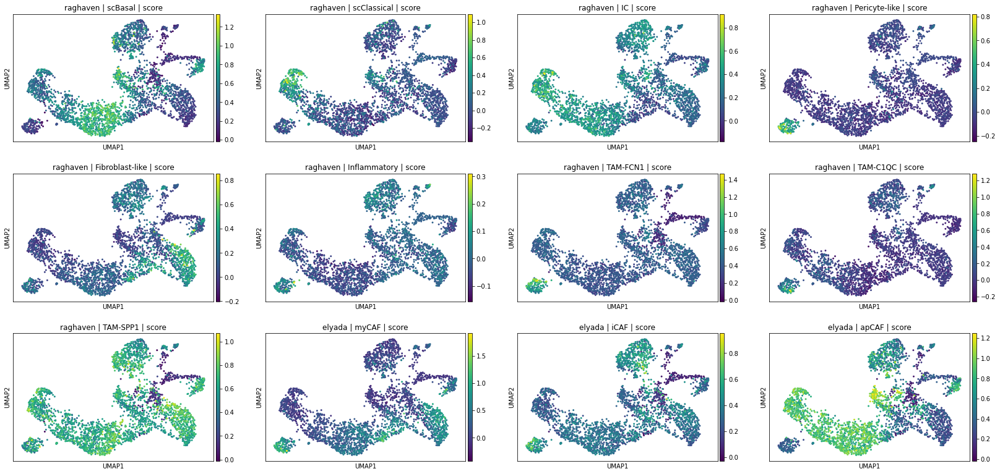

In [91]:
sc.pl.umap(mix, color=[c for c in mix.obs.columns if 'score' in c if ('raghaven' in c or 'elyada' in c)])

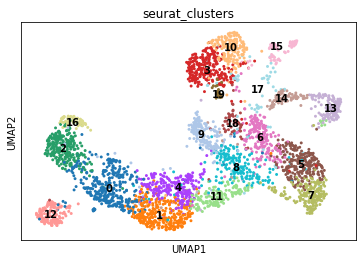

In [90]:
sc.pl.umap(mix, color=['seurat_clusters'], legend_loc='on data', )

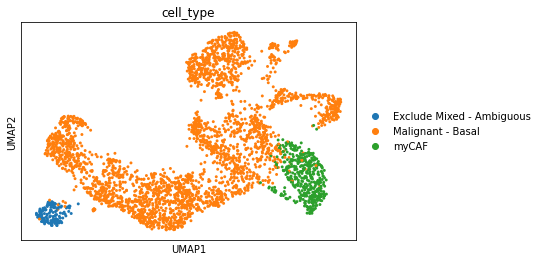

In [95]:
m = {
    'Malignant - Basal': [16, 2, 0, 1, 4, 11, 9, 8, 6, 18, 13, 14, 17, 15, 19, 3, 10],
    'myCAF': [5, 7],
    'Exclude Mixed - Ambiguous': [12],
}
rm = {str(c):k for k, v in m.items() for c in v}
mix.obs['cell_type'] = [rm.get(c) for c in mix.obs['seurat_clusters']]
sc.pl.umap(mix, color='cell_type')

In [96]:
c2t = {c:t for c, t in zip(mix.obs.index, mix.obs['cell_type'])}
sct.obs['cell_type_specific'] = [c2t[x] if x in c2t else ct
                        for x, ct in zip(sct.obs.index, sct.obs['cell_type_specific'])]

#### all

In [59]:
sct.obsm['X_umap'] = counts.obsm['X_umap']
sct.obsm['X_umap_pollock'] = pollock.obsm['X_umap']
sct.obsm['pollock_prediction_probs'] = pollock.obsm['prediction_probs']
sct.layers['counts'] = counts[sct.obs.index, sct.var.index].X

In [62]:
sct.obs['cell_type_specific'] = [c1 if pd.isnull(c2) else c2
                                 for c1, c2 in zip(sct.obs['cell_type'], sct.obs['cell_type_specific'])]

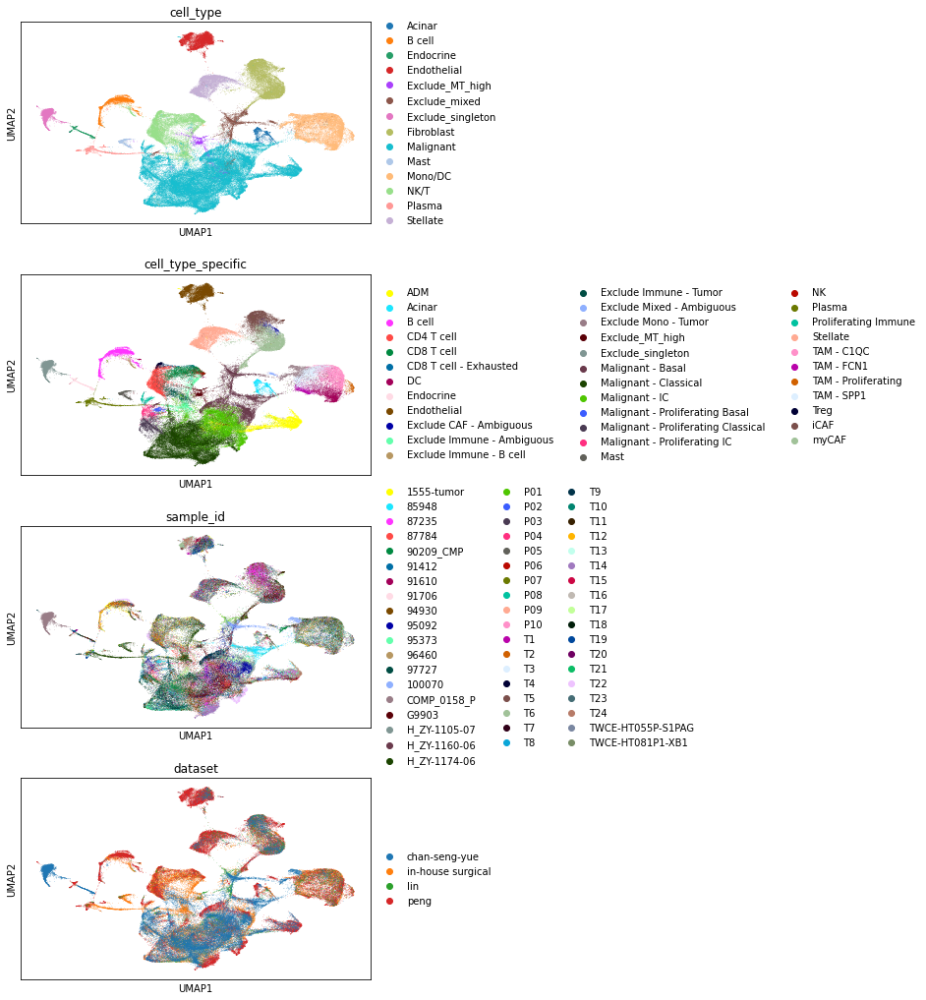

In [97]:
sc.pl.umap(sct, color=['cell_type', 'cell_type_specific', 'sample_id', 'dataset'], ncols=1)

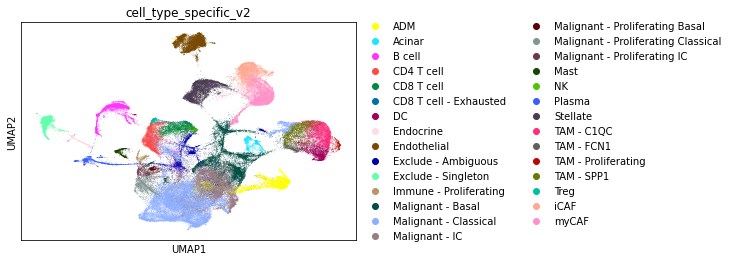

In [103]:
m = {
    'Exclude CAF - Ambiguous': 'myCAF',
    'Exclude Immune - Ambiguous': 'Exclude - Ambiguous',
    'Exclude Immune - B cell': 'B cell',
    'Exclude Immune - Tumor': 'Malignant - Classical',
    'Exclude Mixed - Ambiguous': 'Exclude - Ambiguous',
    'Exclude Mono - Tumor': 'Malignant - Classical',
    'Exclude_MT_high': 'Exclude - Ambiguous',
    'Exclude_singleton': 'Exclude - Singleton',
    'Proliferating Immune': 'Immune - Proliferating'
}
sct.obs['cell_type_specific_v2'] = [m.get(x, x) for x in sct.obs['cell_type_specific']]
sc.pl.umap(sct, color='cell_type_specific_v2')

#### pull out malignant cells and recluster

In [110]:
malignant_cells = sct[[True if ('Malignant' in ct or 'Basal' in ct or 'IC' in ct or 'Classical' in ct) else False
                       for ct in sct.obs['cell_type_specific_v2']]].obs[[]]
malignant_cells

""
1555-tumor_AAACCTGAGTGCGTGA-1
1555-tumor_AAACGGGAGACAATAC-1
1555-tumor_AACACGTGTAAGCACG-1
1555-tumor_AACACGTGTGAAATCA-1
1555-tumor_AACCATGGTACTTCTT-1
...
G9903_filtered_gene_bc_matrices_h5.h5_TTTGCGCCACAGGAGT-1
G9903_filtered_gene_bc_matrices_h5.h5_TTTGCGCGTACCGTAT-1
G9903_filtered_gene_bc_matrices_h5.h5_TTTGCGCTCGTGGACC-1
G9903_filtered_gene_bc_matrices_h5.h5_TTTGGTTGTTGTACAC-1


In [109]:
malignant_cells.to_csv('../data/single_cell/original/malignant_cell_ids.txt', sep='\t', header=False)

In [111]:
malignant = sc.read_h5ad('../data/single_cell/original/integrated_subset_malignant_redo.h5ad')
malignant.raw = sct[malignant.obs.index.to_list()]
keep = [c for c in sct.obs.columns
        if c not in malignant.obs]
malignant.obs = pd.merge(malignant.obs, sct[malignant.obs.index.to_list()].obs[keep],
                         how='left', left_index=True, right_index=True)
malignant

/diskmnt/Projects/Users/estorrs/miniconda3/envs/single-cell-pdac/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,


AnnData object with n_obs × n_vars = 51384 × 3000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type', 'integrated_snn_res.2', 'pollock_cell_type', 'dataset', 'Bailey | ADEX | score', 'Bailey | Squamous-like | score', 'Bailey | Pancreatic-Progenitor | score', 'Bailey | Immunogenic | score', 'Collison | Exocrine-like | score', 'Collison | Quasi-Mesenchymal | score', 'Collison | Classical | score', 'Moffit | Basal | score', 'Moffit | Classical | score', 'subTME | deserted | score', 'subTME | reactive | score', 'raghaven | scBasal | score', 'raghaven | scClassical | score', 'raghaven | IC | score', 'raghaven | Pericyte-like | score', 'raghaven | Fibroblast-like | score', 'raghaven | Inflammatory | score', 'raghaven | TAM-FCN1 | score', 'raghaven | TAM-C1QC | score', 'raghaven | TAM-SPP1 | score', 'elyada | myCAF | score', 

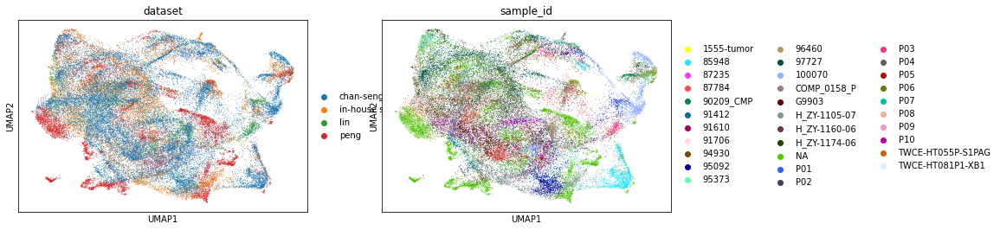

In [112]:
sc.pl.umap(malignant, color=['dataset', 'sample_id'])

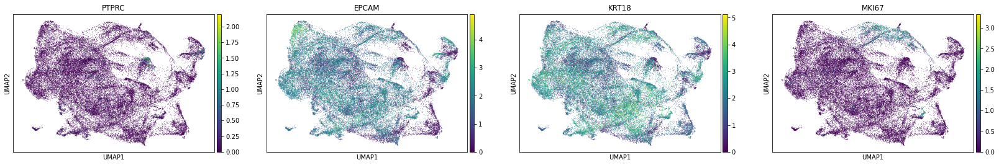

In [121]:
sc.pl.umap(malignant, color=['PTPRC', 'EPCAM', 'KRT18', 'MKI67'])

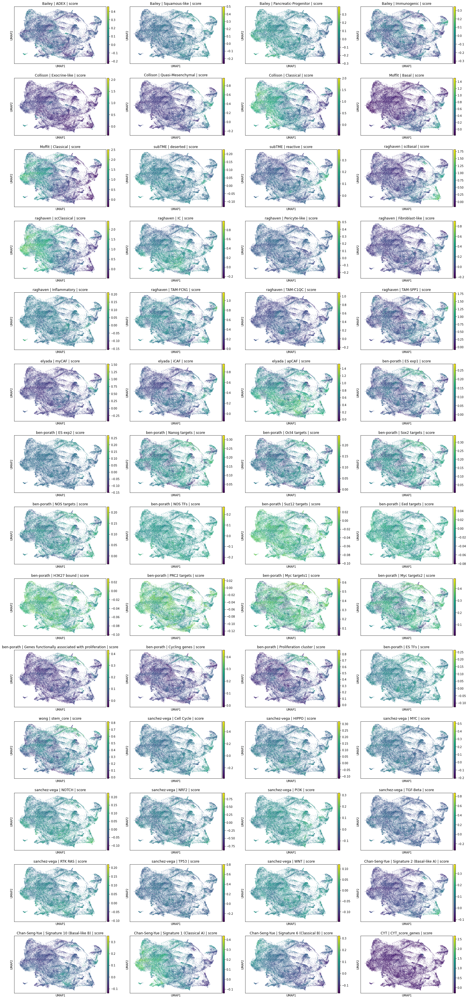

In [114]:
cols = [c for c in malignant.obs.columns if 'score' in c if 'Immunophenogram' not in c if 'MCP' not in c]
sc.pl.umap(malignant, color=cols)

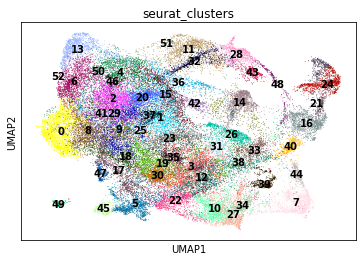

In [120]:
sc.pl.umap(malignant, color=['seurat_clusters'], legend_loc='on data', )

In [125]:
# sc.pl.umap(malignant[pd.isnull(malignant.obs['cell_type'])], color='seurat_clusters')

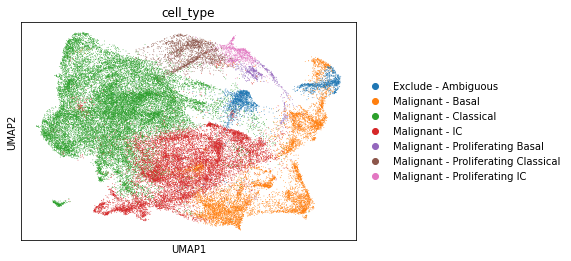

In [124]:
m = {
    'Malignant - Basal': [7, 44, 40, 16, 21, 27, 34, 10, 39],
    'Malignant - IC': [45, 5, 22, 12, 38, 33, 26, 23, 35, 19, 30, 3, 31],
    'Malignant - Classical': [47, 17, 18, 25, 1, 37, 15, 42, 36, 20, 4, 50, 13, 52, 6, 0, 8, 41, 29, 9, 49, 46, 2],
    'Malignant - Proliferating Basal': [43, 48],
    'Malignant - Proliferating IC': [28],
    'Malignant - Proliferating Classical': [51, 11, 32],
    'Exclude - Ambiguous': [24, 14]
}
rm = {str(c):k for k, v in m.items() for c in v}
malignant.obs['cell_type'] = [rm.get(c) for c in malignant.obs['seurat_clusters']]
sc.pl.umap(malignant, color='cell_type')

In [128]:
c2t = {c:t for c, t in zip(malignant.obs.index, malignant.obs['cell_type'])}
sct.obs['malignant_recluster_cell_type'] = [c2t.get(x) for x in sct.obs.index]
sct.obs['cell_type_specific_v3'] = [c2t.get(x, ct)
                                    for x, ct in zip(sct.obs.index, sct.obs['cell_type_specific_v2'])]

#### save all

In [135]:
sct.obs['cell_type_specific_final'] = sct.obs['cell_type_specific_v3'].to_list()

In [138]:
sct.var = sct.var[[]]

In [139]:
sct.write_h5ad('../data/single_cell/checkpoints/non_eus_processed.h5ad')

#### malignant cibersortx

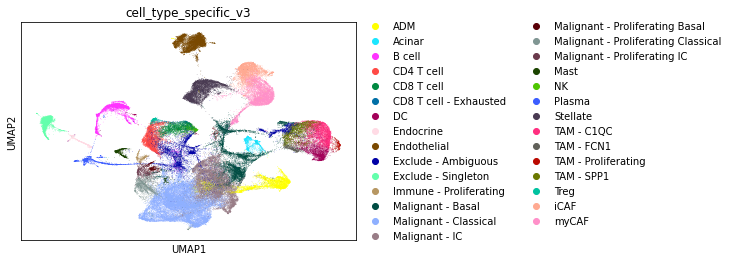

In [129]:
sc.pl.umap(sct, color='cell_type_specific_v3')

In [130]:
keep = [c for c in set(sct.obs['cell_type_specific_v3']) if 'Malignant' in c]
keep += ['ADM']
f = sct[[True if ct in keep else False
        for ct in sct.obs['cell_type_specific_v3']]]
f

View of AnnData object with n_obs × n_vars = 53500 × 29227
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type', 'pollock_cell_type', 'dataset', 'Bailey | ADEX | score', 'Bailey | Squamous-like | score', 'Bailey | Pancreatic-Progenitor | score', 'Bailey | Immunogenic | score', 'Collison | Exocrine-like | score', 'Collison | Quasi-Mesenchymal | score', 'Collison | Classical | score', 'Moffit | Basal | score', 'Moffit | Classical | score', 'subTME | deserted | score', 'subTME | reactive | score', 'raghaven | scBasal | score', 'raghaven | scClassical | score', 'raghaven | IC | score', 'raghaven | Pericyte-like | score', 'raghaven | Fibroblast-like | score', 'raghaven | Inflammatory | score', 'raghaven | TAM-FCN1 | score', 'raghaven | TAM-C1QC | score', 'raghaven | TAM-SPP1 | score', 'elyada | myCAF | score', 'elyada | iCAF 

In [131]:
# save counts for cytotrace
df = pd.DataFrame(data=f.layers['counts'].toarray(), columns=f.var.index.to_list(),
                  index=f.obs.index.to_list(), dtype=int)
df = df.transpose()
df['gene'] = [g.split('.')[0] for g in df.index.to_list()]
df = df.groupby('gene').mean().astype(int)
df.index.name = 'Gene'
# make ids compatible with r
df.columns = ['X' + c for c in df.columns]
df

,X1555-tumor_AAACCTGAGTGCGTGA-1,X1555-tumor_AAACGGGAGACAATAC-1,X1555-tumor_AACCATGGTACTTCTT-1,X1555-tumor_AACCATGTCGTGGTCG-1,X1555-tumor_AACCGCGAGCAATCTC-1,X1555-tumor_AACCGCGTCTTTAGTC-1,X1555-tumor_AACTCAGAGTCTCGGC-1,X1555-tumor_AACTCCCCAAACAACA-1,X1555-tumor_AACTCCCTCCAAACAC-1,X1555-tumor_AACTCTTTCCCTGACT-1,...,XG9903_filtered_gene_bc_matrices_h5.h5_TTTCCTCCACACATGT-1,XG9903_filtered_gene_bc_matrices_h5.h5_TTTCCTCCATTCGACA-1,XG9903_filtered_gene_bc_matrices_h5.h5_TTTCCTCTCAGCACAT-1,XG9903_filtered_gene_bc_matrices_h5.h5_TTTCCTCTCCCAAGTA-1,XG9903_filtered_gene_bc_matrices_h5.h5_TTTGCGCAGAGTAAGG-1,XG9903_filtered_gene_bc_matrices_h5.h5_TTTGCGCCACAGGAGT-1,XG9903_filtered_gene_bc_matrices_h5.h5_TTTGCGCGTACCGTAT-1,XG9903_filtered_gene_bc_matrices_h5.h5_TTTGCGCTCGTGGACC-1,XG9903_filtered_gene_bc_matrices_h5.h5_TTTGGTTGTTGTACAC-1,XG9903_filtered_gene_bc_matrices_h5.h5_TTTGTCATCCGAACGC-1
Gene,,,,,,,,,,,,,,,,,,,,,
7SK,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
A1BG,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A1BG-AS1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A1CF,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A2M,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZZZ3,0,0,0,0,0,0,0,0,0,0,...,1,1,0,0,0,0,1,0,1,0
bP-21264C1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
hsa-mir-1199,0,0,0,0,0,0,0,0,0,0,...,0,1,1,0,0,0,0,0,0,0


In [132]:
for dataset in dataset_to_sample_id.keys():
    f = df[[c for c in df.columns if cell_to_dataset[c[1:]]==dataset]]
    print(dataset, f.shape)
    f.to_csv(f'../data/single_cell/cytotrace/inputs/malignant_redo_{dataset}.txt', sep='\t')

in-house surgical (26791, 11253)
lin (26791, 4298)
peng (26791, 13664)
chan-seng-yue (26791, 24285)


In [105]:
[c for c in sct.obs.columns if 'cytotrace' in c]

['cytotrace', 'cytotrace_mesenchymal']

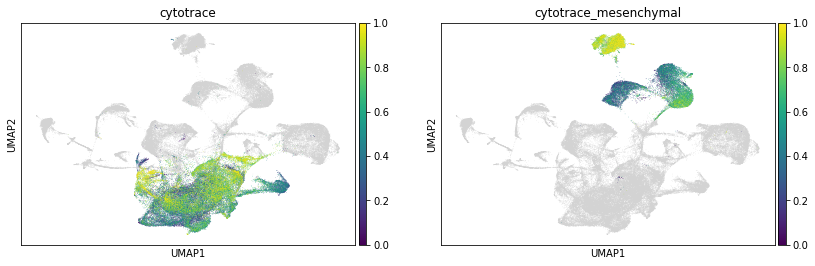

In [106]:
sc.pl.umap(sct, color=['cytotrace', 'cytotrace_mesenchymal'], ncols=2)

In [ ]:
#

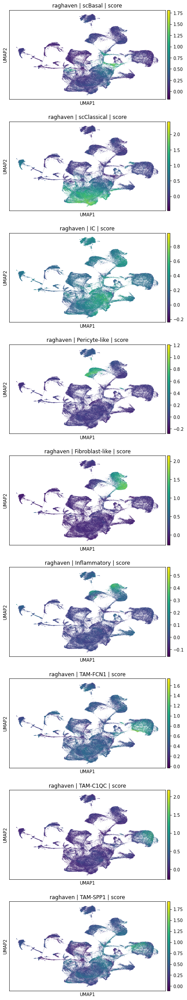

In [79]:
sc.pl.umap(sct, color=[c for c in sct.obs.columns if 'score' in c and 'raghaven' in c], ncols=1)

In [ ]:
# resubsetting malignant cells


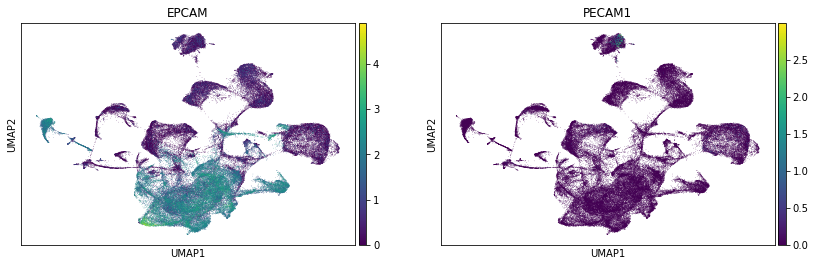

In [77]:
sc.pl.umap(sct, color=['EPCAM', 'PECAM1'])

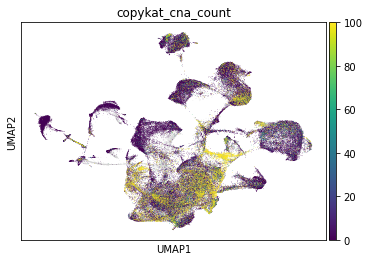

In [75]:
sc.pl.umap(sct, color='copykat_cna_count', vmax=100.)

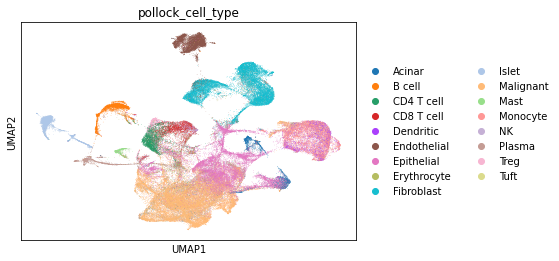

In [68]:
sc.pl.umap(sct, color=['pollock_cell_type'])

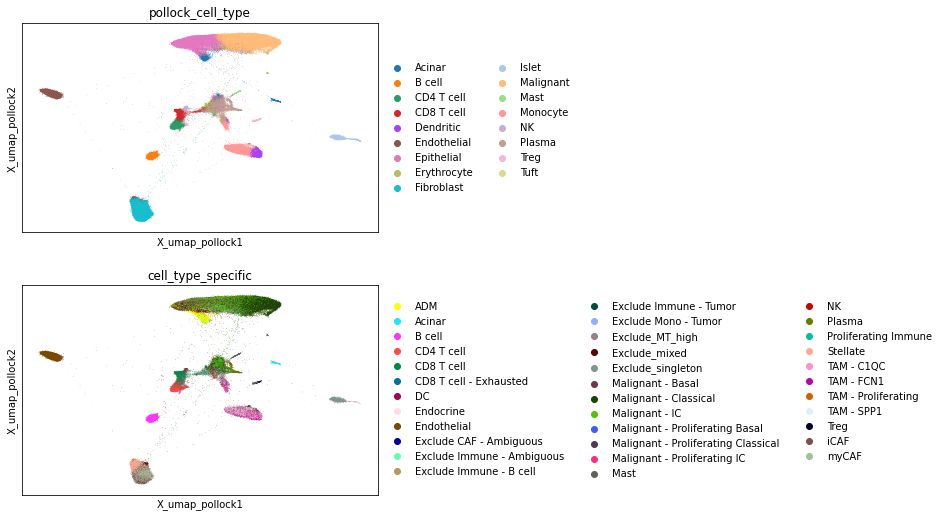

In [73]:
sc.pl.embedding(sct, basis='X_umap_pollock', color=['pollock_cell_type', 'cell_type_specific'], ncols=1)

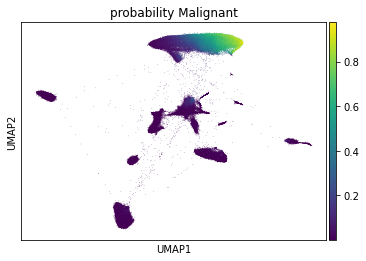

In [71]:
sc.pl.umap(pollock, color='probability Malignant')

In [70]:
pollock

AnnData object with n_obs × n_vars = 113052 × 25019
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.0.75', 'seurat_clusters', 'sample_id', 'cell_type', 'n_counts', 'size_factors', 'y_pred', 'predicted_cell_type_probability', 'predicted_cell_type', 'probability Acinar', 'probability B cell', 'probability CD4 T cell', 'probability CD8 T cell', 'probability Dendritic', 'probability Endothelial', 'probability Epithelial', 'probability Erythrocyte', 'probability Fibroblast', 'probability Islet', 'probability Malignant', 'probability Mast', 'probability Monocyte', 'probability NK', 'probability Plasma', 'probability Treg', 'probability Tuft'
    var: 'mean', 'std'
    uns: 'cell_type_colors', 'predicted_cell_type_colors'
    obsm: 'X_emb', 'X_umap', 'prediction_probs'